###   Import important libraries

In [2]:
import pandas as pd
import numpy as np
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')
import matplotlib.pyplot as plt
from pandas_profiling import ProfileReport
%matplotlib inline

In [3]:
#Uploading dataset
df=pd.read_csv('CarPrice_data.csv')

In [4]:
#Display Dataset
df

,car_ID,symboling,CarName,fueltype,aspiration,doornumber,carbody,drivewheel,enginelocation,wheelbase,...,enginesize,fuelsystem,boreratio,stroke,compressionratio,horsepower,peakrpm,citympg,highwaympg,price
0,1,3,alfa-romero giulia,gas,std,two,convertible,rwd,front,88.6,...,130,mpfi,3.47,2.68,9.0,111,5000,21,27,13495.0
1,2,3,alfa-romero stelvio,gas,std,two,convertible,rwd,front,88.6,...,130,mpfi,3.47,2.68,9.0,111,5000,21,27,16500.0
2,3,1,alfa-romero Quadrifoglio,gas,std,two,hatchback,rwd,front,94.5,...,152,mpfi,2.68,3.47,9.0,154,5000,19,26,16500.0
3,4,2,audi 100 ls,gas,std,four,sedan,fwd,front,99.8,...,109,mpfi,3.19,3.40,10.0,102,5500,24,30,13950.0
4,5,2,audi 100ls,gas,std,four,sedan,4wd,front,99.4,...,136,mpfi,3.19,3.40,8.0,115,5500,18,22,17450.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
200,201,-1,volvo 145e (sw),gas,std,four,sedan,rwd,front,109.1,...,141,mpfi,3.78,3.15,9.5,114,5400,23,28,16845.0
201,202,-1,volvo 144ea,gas,turbo,four,sedan,rwd,front,109.1,...,141,mpfi,3.78,3.15,8.7,160,5300,19,25,19045.0
202,203,-1,volvo 244dl,gas,std,four,sedan,rwd,front,109.1,...,173,mpfi,3.58,2.87,8.8,134,5500,18,23,21485.0
203,204,-1,volvo 246,diesel,turbo,four,sedan,rwd,front,109.1,...,145,idi,3.01,3.40,23.0,106,4800,26,27,22470.0


In [5]:
#Displaying the first five rows of dataset
df.head()

,car_ID,symboling,CarName,fueltype,aspiration,doornumber,carbody,drivewheel,enginelocation,wheelbase,...,enginesize,fuelsystem,boreratio,stroke,compressionratio,horsepower,peakrpm,citympg,highwaympg,price
0,1,3,alfa-romero giulia,gas,std,two,convertible,rwd,front,88.6,...,130,mpfi,3.47,2.68,9.0,111,5000,21,27,13495.0
1,2,3,alfa-romero stelvio,gas,std,two,convertible,rwd,front,88.6,...,130,mpfi,3.47,2.68,9.0,111,5000,21,27,16500.0
2,3,1,alfa-romero Quadrifoglio,gas,std,two,hatchback,rwd,front,94.5,...,152,mpfi,2.68,3.47,9.0,154,5000,19,26,16500.0
3,4,2,audi 100 ls,gas,std,four,sedan,fwd,front,99.8,...,109,mpfi,3.19,3.40,10.0,102,5500,24,30,13950.0
4,5,2,audi 100ls,gas,std,four,sedan,4wd,front,99.4,...,136,mpfi,3.19,3.40,8.0,115,5500,18,22,17450.0


In [6]:
#Displaying the last five rows of dataset
df.tail()

,car_ID,symboling,CarName,fueltype,aspiration,doornumber,carbody,drivewheel,enginelocation,wheelbase,...,enginesize,fuelsystem,boreratio,stroke,compressionratio,horsepower,peakrpm,citympg,highwaympg,price
200,201,-1,volvo 145e (sw),gas,std,four,sedan,rwd,front,109.1,...,141,mpfi,3.78,3.15,9.5,114,5400,23,28,16845.0
201,202,-1,volvo 144ea,gas,turbo,four,sedan,rwd,front,109.1,...,141,mpfi,3.78,3.15,8.7,160,5300,19,25,19045.0
202,203,-1,volvo 244dl,gas,std,four,sedan,rwd,front,109.1,...,173,mpfi,3.58,2.87,8.8,134,5500,18,23,21485.0
203,204,-1,volvo 246,diesel,turbo,four,sedan,rwd,front,109.1,...,145,idi,3.01,3.40,23.0,106,4800,26,27,22470.0
204,205,-1,volvo 264gl,gas,turbo,four,sedan,rwd,front,109.1,...,141,mpfi,3.78,3.15,9.5,114,5400,19,25,22625.0


In [7]:
#checking for dupliocates in dataset
df.duplicated

<bound method DataFrame.duplicated of      car_ID  symboling                   CarName fueltype aspiration  \
0         1          3        alfa-romero giulia      gas        std   
1         2          3       alfa-romero stelvio      gas        std   
2         3          1  alfa-romero Quadrifoglio      gas        std   
3         4          2               audi 100 ls      gas        std   
4         5          2                audi 100ls      gas        std   
..      ...        ...                       ...      ...        ...   
200     201         -1           volvo 145e (sw)      gas        std   
201     202         -1               volvo 144ea      gas      turbo   
202     203         -1               volvo 244dl      gas        std   
203     204         -1                 volvo 246   diesel      turbo   
204     205         -1               volvo 264gl      gas      turbo   

    doornumber      carbody drivewheel enginelocation  wheelbase  ...  \
0          two  converti

In [8]:
#exploring dataset description
df.describe()

,car_ID,symboling,wheelbase,carlength,carwidth,carheight,curbweight,enginesize,boreratio,stroke,compressionratio,horsepower,peakrpm,citympg,highwaympg,price
count,205.000000,205.000000,205.000000,205.000000,205.000000,205.000000,205.000000,205.000000,205.000000,205.000000,205.000000,205.000000,205.000000,205.000000,205.000000,205.000000
mean,103.000000,0.834146,98.756585,174.049268,65.907805,53.724878,2555.565854,126.907317,3.329756,3.255415,10.142537,104.117073,5125.121951,25.219512,30.751220,13276.710571
std,59.322565,1.245307,6.021776,12.337289,2.145204,2.443522,520.680204,41.642693,0.270844,0.313597,3.972040,39.544167,476.985643,6.542142,6.886443,7988.852332
min,1.000000,-2.000000,86.600000,141.100000,60.300000,47.800000,1488.000000,61.000000,2.540000,2.070000,7.000000,48.000000,4150.000000,13.000000,16.000000,5118.000000
25%,52.000000,0.000000,94.500000,166.300000,64.100000,52.000000,2145.000000,97.000000,3.150000,3.110000,8.600000,70.000000,4800.000000,19.000000,25.000000,7788.000000
50%,103.000000,1.000000,97.000000,173.200000,65.500000,54.100000,2414.000000,120.000000,3.310000,3.290000,9.000000,95.000000,5200.000000,24.000000,30.000000,10295.000000
75%,154.000000,2.000000,102.400000,183.100000,66.900000,55.500000,2935.000000,141.000000,3.580000,3.410000,9.400000,116.000000,5500.000000,30.000000,34.000000,16503.000000
max,205.000000,3.000000,120.900000,208.100000,72.300000,59.800000,4066.000000,326.000000,3.940000,4.170000,23.000000,288.000000,6600.000000,49.000000,54.000000,45400.000000


In [9]:
df.info

<bound method DataFrame.info of      car_ID  symboling                   CarName fueltype aspiration  \
0         1          3        alfa-romero giulia      gas        std   
1         2          3       alfa-romero stelvio      gas        std   
2         3          1  alfa-romero Quadrifoglio      gas        std   
3         4          2               audi 100 ls      gas        std   
4         5          2                audi 100ls      gas        std   
..      ...        ...                       ...      ...        ...   
200     201         -1           volvo 145e (sw)      gas        std   
201     202         -1               volvo 144ea      gas      turbo   
202     203         -1               volvo 244dl      gas        std   
203     204         -1                 volvo 246   diesel      turbo   
204     205         -1               volvo 264gl      gas      turbo   

    doornumber      carbody drivewheel enginelocation  wheelbase  ...  \
0          two  convertible   

In [10]:
#checking for number of duplicates
df.duplicated().sum()

0

In [104]:
#checking of shape of data
df.shape

(205, 26)

Dataset has 205 rows and 26 columns

In [11]:
#displaying the 26 columns
df.columns

Index(['car_ID', 'symboling', 'CarName', 'fueltype', 'aspiration',
       'doornumber', 'carbody', 'drivewheel', 'enginelocation', 'wheelbase',
       'carlength', 'carwidth', 'carheight', 'curbweight', 'enginetype',
       'cylindernumber', 'enginesize', 'fuelsystem', 'boreratio', 'stroke',
       'compressionratio', 'horsepower', 'peakrpm', 'citympg', 'highwaympg',
       'price'],
      dtype='object')

In [12]:
#showing symboling range
df.symboling.unique()

array([ 3,  1,  2,  0, -1, -2], dtype=int64)

In [13]:
#carnames
df.CarName.unique()

array(['alfa-romero giulia', 'alfa-romero stelvio',
       'alfa-romero Quadrifoglio', 'audi 100 ls', 'audi 100ls',
       'audi fox', 'audi 5000', 'audi 4000', 'audi 5000s (diesel)',
       'bmw 320i', 'bmw x1', 'bmw x3', 'bmw z4', 'bmw x4', 'bmw x5',
       'chevrolet impala', 'chevrolet monte carlo', 'chevrolet vega 2300',
       'dodge rampage', 'dodge challenger se', 'dodge d200',
       'dodge monaco (sw)', 'dodge colt hardtop', 'dodge colt (sw)',
       'dodge coronet custom', 'dodge dart custom',
       'dodge coronet custom (sw)', 'honda civic', 'honda civic cvcc',
       'honda accord cvcc', 'honda accord lx', 'honda civic 1500 gl',
       'honda accord', 'honda civic 1300', 'honda prelude',
       'honda civic (auto)', 'isuzu MU-X', 'isuzu D-Max ',
       'isuzu D-Max V-Cross', 'jaguar xj', 'jaguar xf', 'jaguar xk',
       'maxda rx3', 'maxda glc deluxe', 'mazda rx2 coupe', 'mazda rx-4',
       'mazda glc deluxe', 'mazda 626', 'mazda glc', 'mazda rx-7 gs',
       'mazda glc 

In [14]:
#engine types
df['enginetype'].unique()

array(['dohc', 'ohcv', 'ohc', 'l', 'rotor', 'ohcf', 'dohcv'], dtype=object)

In [15]:
#fuelsystem types
df['fuelsystem'].unique()

array(['mpfi', '2bbl', 'mfi', '1bbl', 'spfi', '4bbl', 'idi', 'spdi'],
      dtype=object)

In [16]:
#fueltypes
df['fueltype'].unique()

array(['gas', 'diesel'], dtype=object)

fuel is of two types, gas and diesel

###  Multivariate dataset analysis

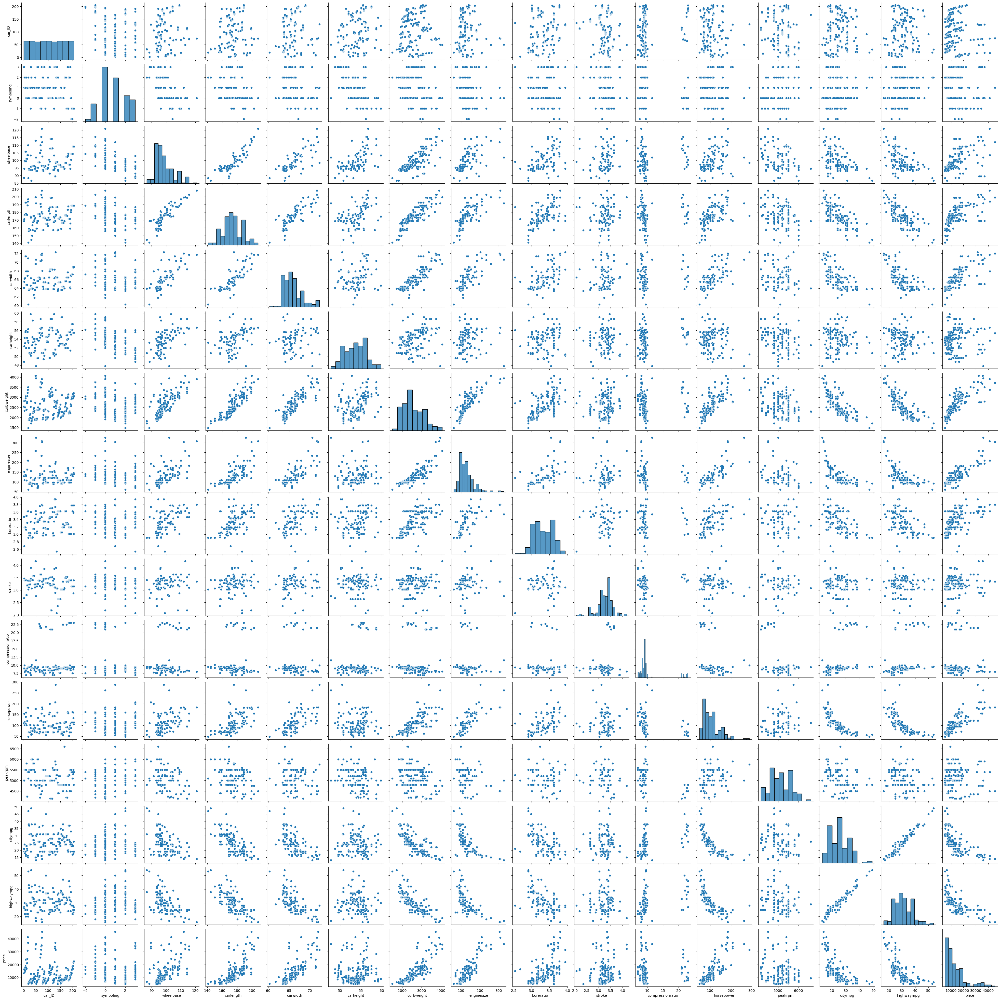

In [18]:
#pairplot of entire dataset
sns.pairplot(df,palette='coolwarm' )

In [22]:
#dataset correlations
df.corr()

,car_ID,symboling,wheelbase,carlength,carwidth,carheight,curbweight,enginesize,boreratio,stroke,compressionratio,horsepower,peakrpm,citympg,highwaympg,price
car_ID,1.000000,-0.151621,0.129729,0.170636,0.052387,0.255960,0.071962,-0.033930,0.260064,-0.160824,0.150276,-0.015006,-0.203789,0.015940,0.011255,-0.109093
symboling,-0.151621,1.000000,-0.531954,-0.357612,-0.232919,-0.541038,-0.227691,-0.105790,-0.130051,-0.008735,-0.178515,0.070873,0.273606,-0.035823,0.034606,-0.079978
wheelbase,0.129729,-0.531954,1.000000,0.874587,0.795144,0.589435,0.776386,0.569329,0.488750,0.160959,0.249786,0.353294,-0.360469,-0.470414,-0.544082,0.577816
carlength,0.170636,-0.357612,0.874587,1.000000,0.841118,0.491029,0.877728,0.683360,0.606454,0.129533,0.158414,0.552623,-0.287242,-0.670909,-0.704662,0.682920
carwidth,0.052387,-0.232919,0.795144,0.841118,1.000000,0.279210,0.867032,0.735433,0.559150,0.182942,0.181129,0.640732,-0.220012,-0.642704,-0.677218,0.759325
carheight,0.255960,-0.541038,0.589435,0.491029,0.279210,1.000000,0.295572,0.067149,0.171071,-0.055307,0.261214,-0.108802,-0.320411,-0.048640,-0.107358,0.119336
curbweight,0.071962,-0.227691,0.776386,0.877728,0.867032,0.295572,1.000000,0.850594,0.648480,0.168790,0.151362,0.750739,-0.266243,-0.757414,-0.797465,0.835305
enginesize,-0.033930,-0.105790,0.569329,0.683360,0.735433,0.067149,0.850594,1.000000,0.583774,0.203129,0.028971,0.809769,-0.244660,-0.653658,-0.677470,0.874145
boreratio,0.260064,-0.130051,0.488750,0.606454,0.559150,0.171071,0.648480,0.583774,1.000000,-0.055909,0.005197,0.573677,-0.254976,-0.584532,-0.587012,0.553173
stroke,-0.160824,-0.008735,0.160959,0.129533,0.182942,-0.055307,0.168790,0.203129,-0.055909,1.000000,0.186110,0.080940,-0.067964,-0.042145,-0.043931,0.079443


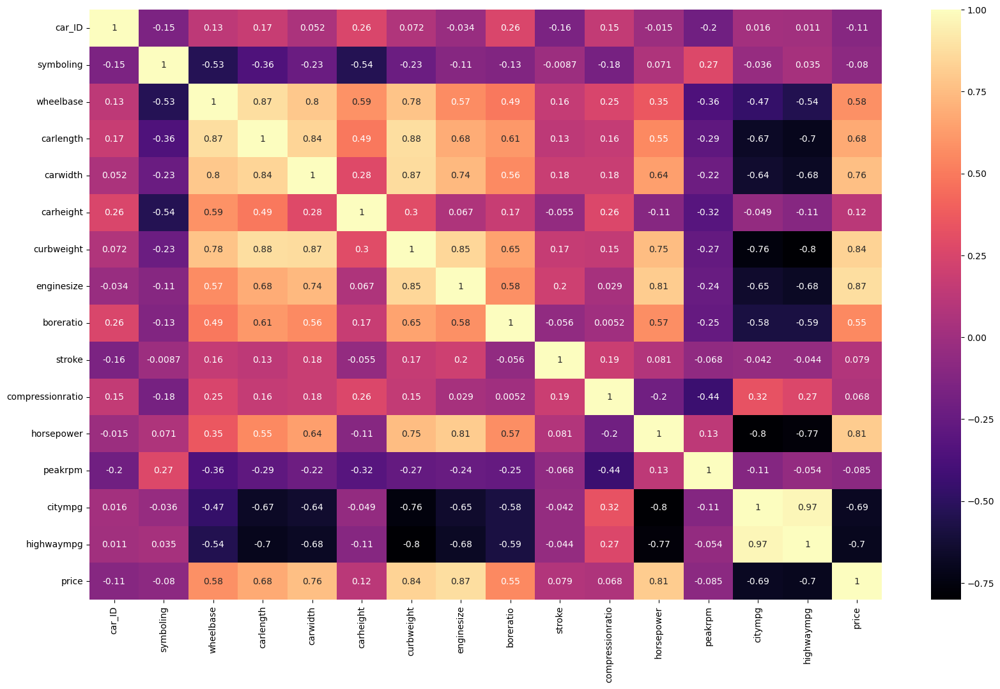

In [23]:
#dataset correlation table
plt.figure(figsize=(20,12))
sns.heatmap(df.corr(), annot=True, cmap="magma",)
plt.show()

# Univariate and Bivariate Dataset analysis

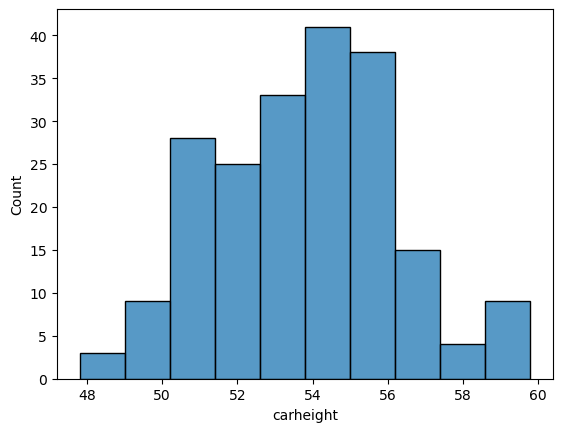

In [96]:
sns.histplot(x='carheight',data=df, bins=10);

In [93]:
df.isnull().sum()

car_ID              0
symboling           0
CarName             0
fueltype            0
aspiration          0
doornumber          0
carbody             0
drivewheel          0
enginelocation      0
wheelbase           0
carlength           0
carwidth            0
carheight           0
curbweight          0
enginetype          0
cylindernumber      0
enginesize          0
fuelsystem          0
boreratio           0
stroke              0
compressionratio    0
horsepower          0
peakrpm             0
citympg             0
highwaympg          0
price               0
dtype: int64

In [25]:
abs(df.corr().price).sort_values(ascending=False)

price               1.000000
enginesize          0.874145
curbweight          0.835305
horsepower          0.808139
carwidth            0.759325
highwaympg          0.697599
citympg             0.685751
carlength           0.682920
wheelbase           0.577816
boreratio           0.553173
carheight           0.119336
car_ID              0.109093
peakrpm             0.085267
symboling           0.079978
stroke              0.079443
compressionratio    0.067984
Name: price, dtype: float64

In [82]:
report=ProfileReport(df)

In [83]:
report

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

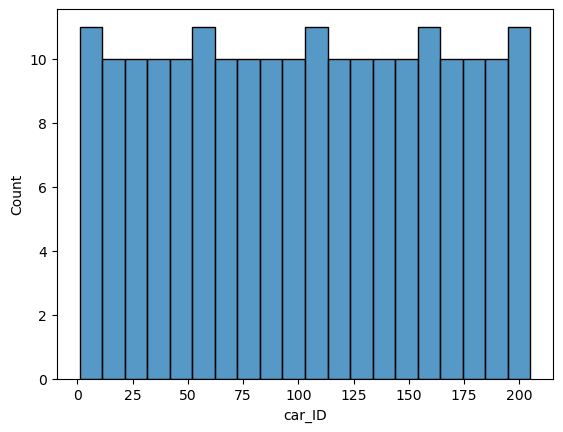

In [26]:
sns.histplot(x='car_ID',data=df, bins=20);

In [113]:
#showing carnames with respect to the ones with highest price
carname_price=df[['CarName','price']].groupby(['CarName']).mean().sort_values(by = 'price',ascending = False)

In [114]:
carname_price

,price
CarName,
buick regal sport coupe (turbo),45400.0
bmw x5,41315.0
buick century special,40960.0
porsche boxter,37028.0
jaguar xk,36000.0
...,...
Nissan versa,5499.0
mitsubishi mirage,5389.0
toyota corona mark ii,5348.0


<AxesSubplot:ylabel='CarName'>

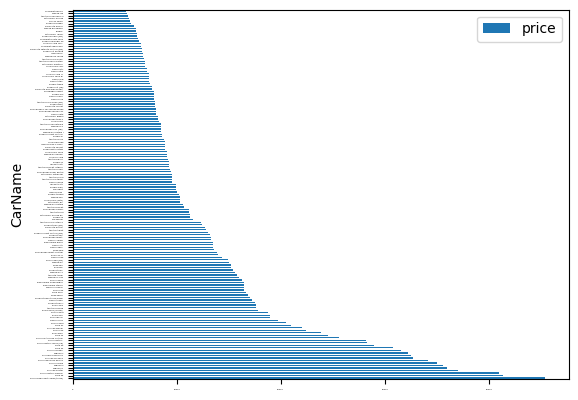

In [119]:
carname_price.plot(kind='barh',fontsize=1.5)

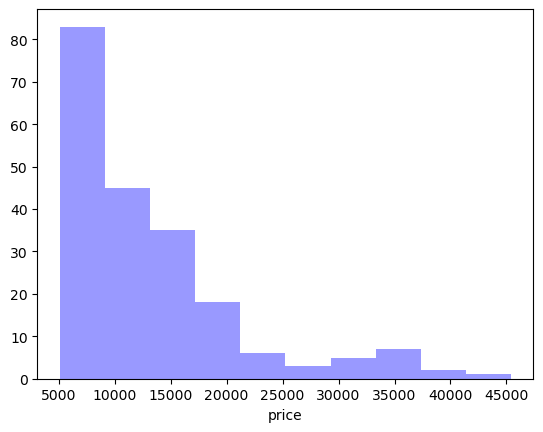

In [28]:
plot = sns.distplot(df.price, kde=False,color="b",bins=10)
plt.show()

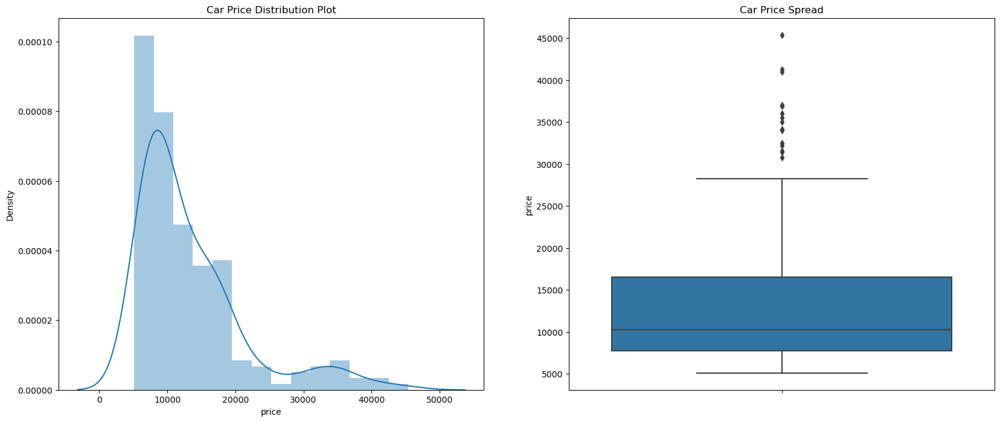

In [29]:
plt.figure(figsize=(20,8))

plt.subplot(1,2,1)
plt.title('Car Price Distribution Plot')
sns.distplot(df.price)

plt.subplot(1,2,2)
plt.title('Car Price Spread')
sns.boxplot(y=df.price)

plt.show()

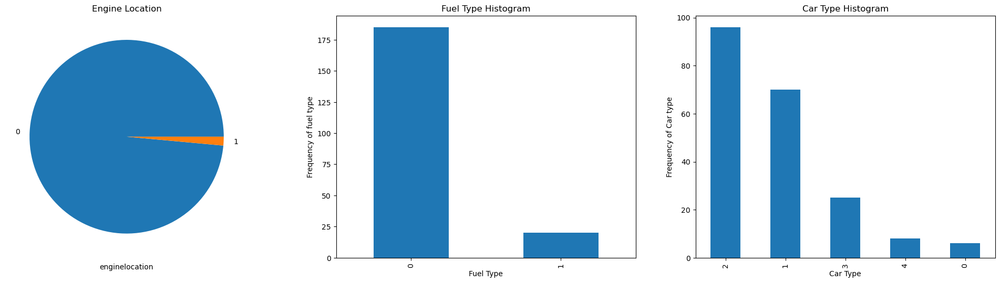

In [89]:
plt.figure(figsize=(25, 6))

plt.subplot(1,3,1)
plt1 = df.enginelocation.value_counts().plot(kind='pie')
plt.title('Engine Location')
plt1.set(xlabel = 'enginelocation', ylabel='')

plt.subplot(1,3,2)
plt1 = df.fueltype.value_counts().plot(kind='bar')
plt.title('Fuel Type Histogram')
plt1.set(xlabel = 'Fuel Type', ylabel='Frequency of fuel type')

plt.subplot(1,3,3)
plt1 = df.carbody.value_counts().plot(kind='bar')
plt.title('Car Type Histogram')
plt1.set(xlabel = 'Car Type', ylabel='Frequency of Car type')

plt.show()

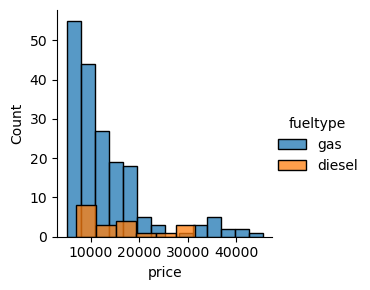

In [31]:
sns.FacetGrid(data=df, hue='fueltype').map(sns.histplot,'price').add_legend()

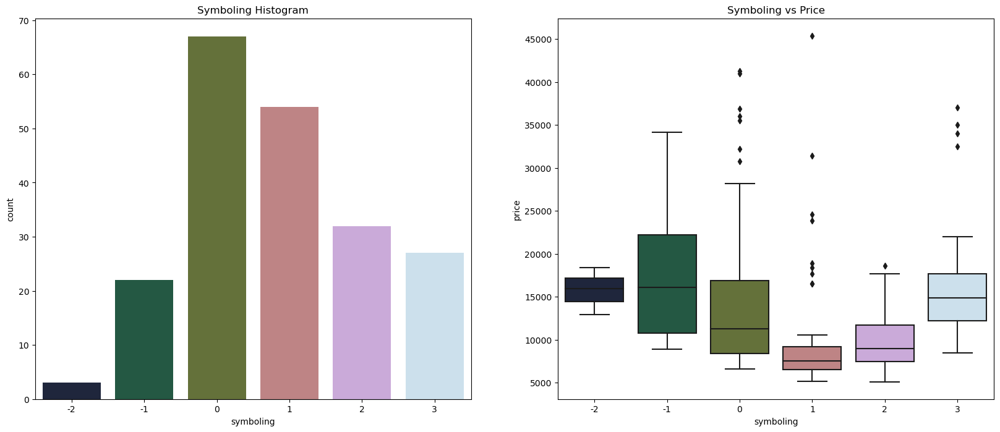

In [11]:
plt.figure(figsize=(20,8))

plt.subplot(1,2,1)
plt.title('Symboling Histogram')
sns.countplot(df.symboling, palette=("cubehelix"))

plt.subplot(1,2,2)
plt.title('Symboling vs Price')
sns.boxplot(x=df.symboling, y=df.price, palette=("cubehelix"))

plt.show()

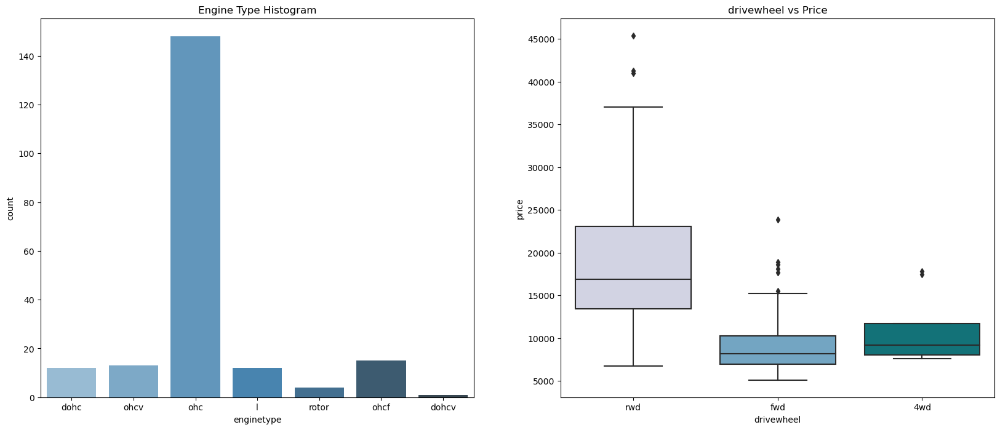

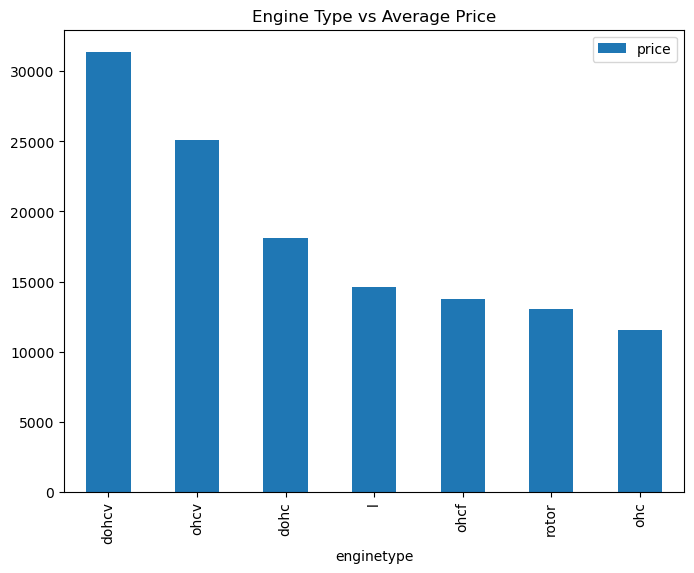

In [12]:
plt.figure(figsize=(20,8))

plt.subplot(1,2,1)
plt.title('Engine Type Histogram')
sns.countplot(df.enginetype, palette=("Blues_d"))

plt.subplot(1,2,2)
plt.title('drivewheel vs Price')
sns.boxplot(x=df.drivewheel, y=df.price, palette=("PuBuGn"))

plt.show()

df = pd.DataFrame(df.groupby(['enginetype'])['price'].mean().sort_values(ascending = False))
df.plot.bar(figsize=(8,6))
plt.title('Engine Type vs Average Price')
plt.show()

<AxesSubplot:xlabel='carwidth', ylabel='carlength'>

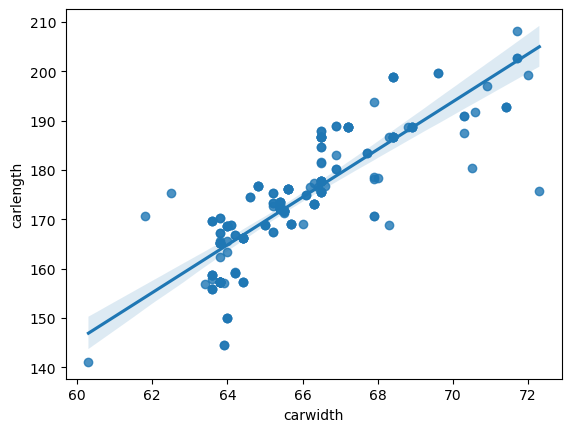

In [56]:
sns.regplot(x='carwidth',y='carlength',data=df)

#   Regression Analysis of Data
### predicting price

In [57]:
#encoding data
for colname in df.select_dtypes("object"):
    df[colname],_=df[colname].factorize()

In [58]:
df.columns

Index(['car_ID', 'symboling', 'CarName', 'fueltype', 'aspiration',
       'doornumber', 'carbody', 'drivewheel', 'enginelocation', 'wheelbase',
       'carlength', 'carwidth', 'carheight', 'curbweight', 'enginetype',
       'cylindernumber', 'enginesize', 'fuelsystem', 'boreratio', 'stroke',
       'compressionratio', 'horsepower', 'peakrpm', 'citympg', 'highwaympg',
       'price'],
      dtype='object')

In [59]:
x=df.head()

In [60]:
x

,car_ID,symboling,CarName,fueltype,aspiration,doornumber,carbody,drivewheel,enginelocation,wheelbase,...,enginesize,fuelsystem,boreratio,stroke,compressionratio,horsepower,peakrpm,citympg,highwaympg,price
0,1,3,0,0,0,0,0,0,0,88.6,...,130,0,3.47,2.68,9.0,111,5000,21,27,13495.0
1,2,3,1,0,0,0,0,0,0,88.6,...,130,0,3.47,2.68,9.0,111,5000,21,27,16500.0
2,3,1,2,0,0,0,1,0,0,94.5,...,152,0,2.68,3.47,9.0,154,5000,19,26,16500.0
3,4,2,3,0,0,1,2,1,0,99.8,...,109,0,3.19,3.40,10.0,102,5500,24,30,13950.0
4,5,2,4,0,0,1,2,2,0,99.4,...,136,0,3.19,3.40,8.0,115,5500,18,22,17450.0


In [61]:
y=df["price"]

In [62]:
y.shape

(205,)

In [63]:
from sklearn.preprocessing import StandardScaler

In [64]:
scaler=StandardScaler()
x=scaler.fit_transform(x)

In [65]:
x

array([[-1.41421356,  1.06904497, -1.41421356,  0.        ,  0.        ,
        -0.81649658, -1.11803399, -0.75      ,  0.        , -1.13332262,
        -1.01709526, -1.16796938, -1.17596712, -0.36535703, -1.11803399,
        -0.75      , -0.10150259,  0.        ,  0.93560688, -1.221739  ,
         0.        , -0.41745641, -0.81649658,  0.19425717,  0.23284516,
        -1.33448233],
       [-0.70710678,  1.06904497, -0.70710678,  0.        ,  0.        ,
        -0.81649658, -1.11803399, -0.75      ,  0.        , -1.13332262,
        -1.01709526, -1.16796938, -1.17596712, -0.36535703, -1.11803399,
        -0.75      , -0.10150259,  0.        ,  0.93560688, -1.221739  ,
         0.        , -0.41745641, -0.81649658,  0.19425717,  0.23284516,
         0.58975922],
       [ 0.        , -1.60356745,  0.        ,  0.        ,  0.        ,
        -0.81649658,  0.        , -0.75      ,  0.        ,  0.06499341,
        -0.33903175,  0.24164884,  0.27385536,  1.11218977,  0.        ,
       

In [66]:
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split

In [67]:
y=df['price']
x=df.drop('price',axis=1)

In [68]:
#splitting data for testing and training
x_train, x_test, y_train, y_test = train_test_split(x,y,test_size=0.7,random_state=100)

In [69]:
x_train,x_test,y_train,y_test=train_test_split(x,y,test_size=0.7)
print("x train: ",x_train.shape)
print("x test: ",x_test.shape)
print("y train: ",y_train.shape)
print("y test: ",y_test.shape)

x train:  (61, 25)
x test:  (144, 25)
y train:  (61,)
y test:  (144,)


In [70]:
from sklearn.linear_model import LinearRegression

In [71]:
model=LinearRegression()

In [72]:
model.fit(x_train, y_train)

LinearRegression()

In [73]:
print(model.intercept_)
print(model.coef_)

15828.592086599467
[ 1.29971594e+02 -3.95879014e+02 -2.05981275e+02 -8.33502310e+03
  4.82603464e+03 -3.45716164e+02  1.78355210e+02 -1.18922965e+03
  1.24582993e+04 -3.07441906e+02  1.95869619e+00  3.49838243e+02
  5.39148335e+00  5.99261635e+00  5.11967905e+02  1.08157878e+03
  6.02468387e+01 -6.62529449e+02 -4.19978223e+03 -1.48786923e+03
  8.64139089e+02 -3.09678262e+00 -5.82035204e-01 -1.22290186e+02
 -6.06443988e+00]


In [74]:
from sklearn.metrics import r2_score,mean_absolute_error,mean_squared_error

In [75]:
predictions= model.predict(x_test)

In [76]:
predictions

array([ 8210.59335757,  6429.90029696, 16672.39850189, 13820.89760965,
       10660.58866515,  8062.26147747, 24644.26820409,  6448.41504668,
       13900.10942114,  6173.27916126, 14437.39341575, 11812.94914425,
        8927.38941577, 11969.4365197 , 19292.80066409,  8122.99575365,
       13610.46862364, 22418.42957832,  6674.75780072, 13880.56968568,
       15509.79513071,  5166.54148427,  5586.53138795, 18172.98946991,
        8074.70638331,  8956.38350797,  8301.22827977, 24292.60892378,
       11685.80697562, 10939.52022594, 12150.33119256,  8303.86046338,
       11554.25158369, 17883.34935821, 17908.51949839,  6594.1198265 ,
        5333.23400282, 11092.08540874, 12899.36274708, 14186.62039441,
       18159.26686569, 18527.37390433, 15293.55504999, 11109.79351773,
       19779.97052242,  6299.12229982, 12994.92119868,  7947.57032912,
       10312.78445799, 23332.37961757,  7098.27704401,  6558.87831306,
       21349.35516713,  6653.05840744,  6975.01342117, 16805.96856868,
      

In [77]:
score=r2_score(predictions,y_test)

In [78]:
score

0.7437463601459856

In [79]:
print(model.score(x_train,y_train))

0.9687785281735435


In [80]:
print(model.score(x_test,y_test))

0.8144749122300077


#   OBSERVATIONS

.Car price is affected by engine location, fueltype, door number , carwidth, car length,carwidth drivewheel, enginetype etc
From the data used for this analysis, it is clear that, cars with the front location of engine will have the most patronahe that the ones with their engine at the rear.

.Cars that use diesel as fuel, have low patronage compared to cars that use gas

. The number of doors a car has will also influence its patronage, hence cars with four doors gets the most patronage copared to cars with two doors
. Car with, car length and car heigth is relative with a bit of significance on choice, and capabilities.

. Drivewheel, in relation to price, 'rwd' has the most patronage, followed by 'fwd' then lastly '4wd'.

. Engine type 'dohcv' has the most patronage, followed by 'ohcv' and 'dohc' and other types.